In [ ]:
!apt-get install unrar -y
!unrar x /content/PeopleArt-master.rar


Streaming output truncated to the last 5000 lines.
Extracting  PeopleArt-master/Annotations/PosterArtRealism/rolf-amstrong_ridin-high-1941.jpg.xml       0%  OK 
Extracting  PeopleArt-master/Annotations/PosterArtRealism/rolf-amstrong_self-portrait-1914.jpg.xml       0%  OK 
Extracting  PeopleArt-master/Annotations/PosterArtRealism/rolf-amstrong_study-of-a-pin-up-emerging-from-blue.jpg.xml       0%  OK 
Extracting  PeopleArt-master/Annotations/PosterArtRealism/rolf-amstrong_take-it-easy-part-of-armstrong-s-cowgirl-series-1941.jpg.xml       0%  OK 
Extracting  PeopleArt-master/Annotations/PosterArtRealism/rolf-amstrong_the-red-head-and-the-blonde.jpg.xml       0%  OK 
Extracting  PeopleArt-master/Annotations/PosterArtRealism/rolf-amstrong_the-shrine-1928.jpg.xml       0%  OK 
Extracting  PeopleArt-master/Annotations/PosterArtRealism/rolf-amstrong_try-this-cowgirl-with-lasso.jpg.xml       0%  OK 
Extracting  PeopleArt-master/An

In [ ]:
!ls -l /content/PeopleArt-master


total 20
drwxr-xr-x 44 root root 4096 Jun  5 06:22 Annotations
-rw-r--r--  1 root root  268 Oct 25  2016 citation.bib
drwxr-xr-x 44 root root 4096 Jun  5 06:22 JPEGImages
-rw-r--r--  1 root root 2521 Oct 25  2016 README.md
-rw-r--r--  1 root root    5 Oct 25  2016 version


In [ ]:
import os
import xml.etree.ElementTree as ET
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import shutil

# PyTorch
import torch
import torchvision
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.transforms import functional as F
from torchvision.datasets import VisionDataset
from torch.utils.data import DataLoader, random_split

from torchvision.ops import box_iou
from collections import defaultdict
import numpy as np


In [ ]:

annotations_dir = "/content/PeopleArt-master/Annotations"
images_dir = "/content/PeopleArt-master/JPEGImages"

# List to store photos containing people
valid_images = []


for style in tqdm(os.listdir(annotations_dir)):
    style_path = os.path.join(annotations_dir, style)
    if not os.path.isdir(style_path):
        continue
    for filename in os.listdir(style_path):
        if not filename.endswith(".xml"):
            continue
        xml_path = os.path.join(style_path, filename)
        tree = ET.parse(xml_path)
        root = tree.getroot()

        has_person = False
        for obj in root.findall("object"):
            name = obj.find("name").text
            if name == "person":
                has_person = True
                break

        if has_person:
            # The image is considered valid if it contains a person.
            image_filename = root.find("filename").text
            style_folder = root.find("folder").text
            image_path = os.path.join(images_dir, style_folder, image_filename)
            if os.path.exists(image_path):
                valid_images.append((image_path, xml_path))


100%|██████████| 46/46 [00:00<00:00, 494.43it/s]


In [ ]:
from sklearn.model_selection import train_test_split

# Initial split into train and val+test
train_val_split, test_split = train_test_split(valid_images, test_size=0.15, random_state=42)
train_split, val_split = train_test_split(train_val_split, test_size=0.1765, random_state=42)  # 0.1765 × 0.85 ≈ 0.15

print(f"Number of training images: {len(train_split)}")
print(f"Number of val images: {len(val_split)}")
print(f"Number of test images: {len(test_split)}")


Number of training images: 909
Number of val images: 195
Number of test images: 195


In [ ]:
from PIL import Image

class PeopleArtDataset(VisionDataset):
    def __init__(self, image_annotation_list, transforms=None):
        self.data = image_annotation_list
        self.transforms = transforms

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        image_path, xml_path = self.data[idx]


        image = Image.open(image_path).convert("RGB")

        # Reading XML file
        tree = ET.parse(xml_path)
        root = tree.getroot()

        boxes = []
        labels = []

        for obj in root.findall("object"):
            name = obj.find("name").text
            if name != "person":
                continue

            bndbox = obj.find("bndbox")
            xmin = int(bndbox.find("xmin").text)
            ymin = int(bndbox.find("ymin").text)
            xmax = int(bndbox.find("xmax").text)
            ymax = int(bndbox.find("ymax").text)
            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(1)  # We use label 1 only because we detect "person"

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        target = {
            "boxes": boxes,
            "labels": labels,
            "image_id": torch.tensor([idx]),
        }

        if self.transforms:
            image = self.transforms(image)

        return image, target


In [ ]:
from torchvision import transforms

# Augmentation
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(p=0.3),
    transforms.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1),
    transforms.RandomGrayscale(p=0.03),  # Helps with artistic styles
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    transforms.RandomErasing(p=0.5, scale=(0.02, 0.2)),  # Forces robust features
])

val_test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],  # NORMALIZE VAL/TEST TOO
                        std=[0.229, 0.224, 0.225])
])

train_dataset = PeopleArtDataset(train_split, transforms=train_transform)
val_dataset = PeopleArtDataset(val_split, transforms=val_test_transform)
test_dataset = PeopleArtDataset(test_split, transforms=val_test_transform)

# DataLoaders
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))


In [ ]:
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2

model = fasterrcnn_resnet50_fpn_v2(weights='COCO_V1')


num_classes = 2

in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

# Higher thresholds to reduce false positives
model.roi_heads.score_thresh = 0.3  # Default: 0.05 (raised to filter weak detections)
model.roi_heads.nms_thresh = 0.6    # Default: 0.5 (more aggressive box suppression)
model.roi_heads.detections_per_img = 50  # Default: 100 (reduce prediction flood)

#GPU
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
model.to(device)


Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth
100%|██████████| 167M/167M [00:00<00:00, 181MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [ ]:
def evaluate(model, data_loader, device, iou_thresholds=[0.5]):
    model.eval()
    all_detections = []
    all_ground_truths = []
    results = defaultdict(list)

    with torch.no_grad():
        for images, targets in tqdm(data_loader, desc="Evaluating"):
            images = [img.to(device) for img in images]

            # Get model predictions
            predictions = model(images)

            for i, (target, prediction) in enumerate(zip(targets, predictions)):
                # Convert everything to CPU for evaluation
                gt_boxes = target['boxes'].cpu()
                pred_boxes = prediction['boxes'].cpu()
                pred_scores = prediction['scores'].cpu()
                pred_labels = prediction['labels'].cpu()

                # Store ground truths
                all_ground_truths.append({
                    'boxes': gt_boxes,
                    'labels': torch.ones_like(target['labels'].cpu())  # All are person class
                })

                # Store detections
                all_detections.append({
                    'boxes': pred_boxes,
                    'scores': pred_scores,
                    'labels': pred_labels
                })

    # Calculate metrics for each IoU threshold
    aps = []
    for iou_thresh in iou_thresholds:
        ap, precision, recall = calculate_metrics(
            all_detections,
            all_ground_truths,
            iou_threshold=iou_thresh
        )

        results[f'AP@{iou_thresh}'].append(ap)
        results['Precision'].append(precision)
        results['Recall'].append(recall)
        aps.append(ap)

    # Calculate mAP@0.5:0.95 if we have multiple thresholds
    if len(iou_thresholds) > 1:
        results['mAP@0.5:0.95'] = np.mean(aps)

    return results

def calculate_metrics(detections, ground_truths, iou_threshold=0.5):
    # Initialize counters
    true_positives = []
    false_positives = []
    total_ground_truth = sum(len(gt['boxes']) for gt in ground_truths)

    # For each image
    for det, gt in zip(detections, ground_truths):
        gt_boxes = gt['boxes']
        det_boxes = det['boxes']
        det_scores = det['scores']

        # Initialize matches for this image
        matched_gt = [False] * len(gt_boxes)
        image_tp = np.zeros(len(det_boxes))
        image_fp = np.zeros(len(det_boxes))

        if len(det_boxes) == 0:
            continue

        if len(gt_boxes) == 0:
            false_positives.extend([1] * len(det_boxes))
            true_positives.extend([0] * len(det_boxes))
            continue

        # Calculate IoU matrix
        iou_matrix = box_iou(det_boxes, gt_boxes)

        # Sort detections by confidence
        sorted_indices = np.argsort(-det_scores)

        for d in sorted_indices:
            ious = iou_matrix[d]
            best_gt = np.argmax(ious)
            best_iou = ious[best_gt]

            if best_iou >= iou_threshold and not matched_gt[best_gt]:
                matched_gt[best_gt] = True
                image_tp[d] = 1
            else:
                image_fp[d] = 1

        true_positives.extend(image_tp)
        false_positives.extend(image_fp)

    # Convert to numpy arrays
    tp = np.array(true_positives)
    fp = np.array(false_positives)

    # Compute cumulative sums
    tp_cumsum = np.cumsum(tp)
    fp_cumsum = np.cumsum(fp)

    # Calculate precision and recall
    precision = tp_cumsum / (tp_cumsum + fp_cumsum + 1e-6)
    recall = tp_cumsum / (total_ground_truth + 1e-6)

    # Ensure metrics are within [0, 1]
    precision = np.clip(precision, 0, 1)
    recall = np.clip(recall, 0, 1)

    # Calculate AP
    ap = compute_ap(recall, precision)

    return ap, precision[-1], recall[-1]

def compute_ap(recall, precision):
    # Append sentinel values
    mrec = np.concatenate(([0.], recall, [1.]))
    mpre = np.concatenate(([0.], precision, [0.]))

    # Compute precision envelope
    for i in range(mpre.size - 1, 0, -1):
        mpre[i - 1] = np.maximum(mpre[i - 1], mpre[i])

    # Find points where recall changes
    i = np.where(mrec[1:] != mrec[:-1])[0]

    # Sum area under curve
    ap = np.sum((mrec[i + 1] - mrec[i]) * mpre[i + 1])
    return ap

In [ ]:
import time
from collections import defaultdict
from tqdm import tqdm

# Optimizer and Scheduler
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.002, momentum=0.9, weight_decay=0.005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

num_epochs = 10
patience = 5  # early stopping
best_val_loss = float('inf')
epochs_without_improvement = 0

train_losses = []
val_losses = []

for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")

    # ========= Training =========
    model.train()
    epoch_train_loss = 0.0
    batch_count = 0

    for images, targets in tqdm(train_loader):
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        loss_value = losses.item()
        epoch_train_loss += loss_value
        batch_count += 1

        if batch_count % 10 == 0 or batch_count == 1 or batch_count == len(train_loader):
            print(f"  Batch {batch_count}/{len(train_loader)} - Loss: {loss_value:.4f}")

    avg_train_loss = epoch_train_loss / batch_count
    train_losses.append(avg_train_loss)
    print(f" Average Train Loss: {avg_train_loss:.4f}")



Epoch 1/10


  0%|          | 1/228 [00:03<14:07,  3.73s/it]

  Batch 1/228 - Loss: 0.9459


  4%|▍         | 10/228 [00:18<06:39,  1.83s/it]

  Batch 10/228 - Loss: 0.4925


  9%|▉         | 20/228 [00:37<06:40,  1.92s/it]

  Batch 20/228 - Loss: 0.2252


 13%|█▎        | 30/228 [00:56<07:20,  2.22s/it]

  Batch 30/228 - Loss: 0.4381


 18%|█▊        | 40/228 [01:14<06:09,  1.96s/it]

  Batch 40/228 - Loss: 0.4458


 22%|██▏       | 50/228 [01:34<06:14,  2.10s/it]

  Batch 50/228 - Loss: 0.5088


 26%|██▋       | 60/228 [01:54<05:42,  2.04s/it]

  Batch 60/228 - Loss: 0.5108


 31%|███       | 70/228 [02:14<05:19,  2.02s/it]

  Batch 70/228 - Loss: 0.6417


 35%|███▌      | 80/228 [02:33<05:12,  2.11s/it]

  Batch 80/228 - Loss: 0.3481


 39%|███▉      | 90/228 [02:53<04:44,  2.06s/it]

  Batch 90/228 - Loss: 0.5284


 44%|████▍     | 100/228 [03:12<04:05,  1.91s/it]

  Batch 100/228 - Loss: 0.3496


 48%|████▊     | 110/228 [03:32<03:52,  1.97s/it]

  Batch 110/228 - Loss: 0.1922


 53%|█████▎    | 120/228 [03:52<03:39,  2.04s/it]

  Batch 120/228 - Loss: 0.2039


 57%|█████▋    | 130/228 [04:13<03:31,  2.16s/it]

  Batch 130/228 - Loss: 0.1470


 61%|██████▏   | 140/228 [04:34<03:11,  2.18s/it]

  Batch 140/228 - Loss: 0.4278


 66%|██████▌   | 150/228 [04:54<02:30,  1.93s/it]

  Batch 150/228 - Loss: 0.1877


 70%|███████   | 160/228 [05:12<02:06,  1.85s/it]

  Batch 160/228 - Loss: 0.2109


 75%|███████▍  | 170/228 [05:32<01:48,  1.88s/it]

  Batch 170/228 - Loss: 0.3198


 79%|███████▉  | 180/228 [05:52<01:36,  2.00s/it]

  Batch 180/228 - Loss: 0.9897


 83%|████████▎ | 190/228 [06:11<01:16,  2.02s/it]

  Batch 190/228 - Loss: 0.4071


 88%|████████▊ | 200/228 [06:31<00:56,  2.03s/it]

  Batch 200/228 - Loss: 0.4497


 92%|█████████▏| 210/228 [06:52<00:37,  2.09s/it]

  Batch 210/228 - Loss: 0.4895


 96%|█████████▋| 220/228 [07:13<00:16,  2.02s/it]

  Batch 220/228 - Loss: 0.1533


100%|██████████| 228/228 [07:27<00:00,  1.96s/it]


  Batch 228/228 - Loss: 0.1470
 Average Train Loss: 0.3529

Epoch 2/10


  0%|          | 1/228 [00:02<08:28,  2.24s/it]

  Batch 1/228 - Loss: 0.1938


  4%|▍         | 10/228 [00:21<07:36,  2.09s/it]

  Batch 10/228 - Loss: 0.4627


  9%|▉         | 20/228 [00:41<07:19,  2.11s/it]

  Batch 20/228 - Loss: 0.6805


 13%|█▎        | 30/228 [01:01<06:26,  1.95s/it]

  Batch 30/228 - Loss: 0.1350


 18%|█▊        | 40/228 [01:22<06:13,  1.99s/it]

  Batch 40/228 - Loss: 0.5702


 22%|██▏       | 50/228 [01:40<05:01,  1.70s/it]

  Batch 50/228 - Loss: 0.3707


 26%|██▋       | 60/228 [02:00<05:32,  1.98s/it]

  Batch 60/228 - Loss: 0.2087


 31%|███       | 70/228 [02:20<04:59,  1.90s/it]

  Batch 70/228 - Loss: 0.5951


 35%|███▌      | 80/228 [02:41<05:15,  2.13s/it]

  Batch 80/228 - Loss: 0.2138


 39%|███▉      | 90/228 [02:59<03:52,  1.69s/it]

  Batch 90/228 - Loss: 0.6240


 44%|████▍     | 100/228 [03:18<03:51,  1.81s/it]

  Batch 100/228 - Loss: 0.1520


 48%|████▊     | 110/228 [03:37<03:49,  1.95s/it]

  Batch 110/228 - Loss: 0.3960


 53%|█████▎    | 120/228 [03:57<03:49,  2.12s/it]

  Batch 120/228 - Loss: 0.2126


 57%|█████▋    | 130/228 [04:16<02:53,  1.77s/it]

  Batch 130/228 - Loss: 0.1787


 61%|██████▏   | 140/228 [04:35<03:00,  2.05s/it]

  Batch 140/228 - Loss: 0.1229


 66%|██████▌   | 150/228 [04:55<02:40,  2.06s/it]

  Batch 150/228 - Loss: 0.0824


 70%|███████   | 160/228 [05:15<02:19,  2.05s/it]

  Batch 160/228 - Loss: 0.2454


 75%|███████▍  | 170/228 [05:34<01:55,  2.00s/it]

  Batch 170/228 - Loss: 0.4586


 79%|███████▉  | 180/228 [05:56<01:30,  1.89s/it]

  Batch 180/228 - Loss: 0.1226


 83%|████████▎ | 190/228 [06:15<01:16,  2.01s/it]

  Batch 190/228 - Loss: 0.2081


 88%|████████▊ | 200/228 [06:34<00:49,  1.78s/it]

  Batch 200/228 - Loss: 0.0972


 92%|█████████▏| 210/228 [06:53<00:35,  1.99s/it]

  Batch 210/228 - Loss: 0.2041


 96%|█████████▋| 220/228 [07:12<00:14,  1.85s/it]

  Batch 220/228 - Loss: 0.1151


100%|██████████| 228/228 [07:26<00:00,  1.96s/it]


  Batch 228/228 - Loss: 0.0881
 Average Train Loss: 0.2779

Epoch 3/10


  0%|          | 1/228 [00:01<05:53,  1.56s/it]

  Batch 1/228 - Loss: 0.2954


  4%|▍         | 10/228 [00:19<06:27,  1.78s/it]

  Batch 10/228 - Loss: 0.2162


  9%|▉         | 20/228 [00:40<06:45,  1.95s/it]

  Batch 20/228 - Loss: 0.2938


 13%|█▎        | 30/228 [01:00<06:40,  2.02s/it]

  Batch 30/228 - Loss: 0.0685


 18%|█▊        | 40/228 [01:20<06:21,  2.03s/it]

  Batch 40/228 - Loss: 0.3297


 22%|██▏       | 50/228 [01:39<05:26,  1.83s/it]

  Batch 50/228 - Loss: 0.2164


 26%|██▋       | 60/228 [01:59<05:25,  1.94s/it]

  Batch 60/228 - Loss: 0.4625


 31%|███       | 70/228 [02:18<04:37,  1.76s/it]

  Batch 70/228 - Loss: 0.4500


 35%|███▌      | 80/228 [02:38<05:30,  2.23s/it]

  Batch 80/228 - Loss: 0.3850


 39%|███▉      | 90/228 [02:56<03:57,  1.72s/it]

  Batch 90/228 - Loss: 0.3086


 44%|████▍     | 100/228 [03:15<04:00,  1.88s/it]

  Batch 100/228 - Loss: 0.0798


 48%|████▊     | 110/228 [03:36<04:07,  2.10s/it]

  Batch 110/228 - Loss: 0.3461


 53%|█████▎    | 120/228 [03:56<03:31,  1.95s/it]

  Batch 120/228 - Loss: 0.1597


 57%|█████▋    | 130/228 [04:16<03:22,  2.07s/it]

  Batch 130/228 - Loss: 0.2467


 61%|██████▏   | 140/228 [04:36<02:49,  1.93s/it]

  Batch 140/228 - Loss: 0.1151


 66%|██████▌   | 150/228 [04:54<02:15,  1.74s/it]

  Batch 150/228 - Loss: 0.0989


 70%|███████   | 160/228 [05:14<02:16,  2.01s/it]

  Batch 160/228 - Loss: 0.1805


 75%|███████▍  | 170/228 [05:33<01:55,  1.98s/it]

  Batch 170/228 - Loss: 0.1326


 79%|███████▉  | 180/228 [05:53<01:31,  1.91s/it]

  Batch 180/228 - Loss: 0.3486


 83%|████████▎ | 190/228 [06:12<01:07,  1.79s/it]

  Batch 190/228 - Loss: 0.1458


 88%|████████▊ | 200/228 [06:31<00:52,  1.87s/it]

  Batch 200/228 - Loss: 0.2721


 92%|█████████▏| 210/228 [06:51<00:35,  1.95s/it]

  Batch 210/228 - Loss: 0.6053


 96%|█████████▋| 220/228 [07:11<00:15,  1.94s/it]

  Batch 220/228 - Loss: 0.4484


100%|██████████| 228/228 [07:24<00:00,  1.95s/it]


  Batch 228/228 - Loss: 0.0985
 Average Train Loss: 0.2619

Epoch 4/10


  0%|          | 1/228 [00:01<06:07,  1.62s/it]

  Batch 1/228 - Loss: 0.1003


  4%|▍         | 10/228 [00:19<07:30,  2.07s/it]

  Batch 10/228 - Loss: 0.2611


  9%|▉         | 20/228 [00:39<06:27,  1.86s/it]

  Batch 20/228 - Loss: 0.1874


 13%|█▎        | 30/228 [00:59<06:47,  2.06s/it]

  Batch 30/228 - Loss: 0.2759


 18%|█▊        | 40/228 [01:18<05:58,  1.91s/it]

  Batch 40/228 - Loss: 0.1500


 22%|██▏       | 50/228 [01:37<05:55,  2.00s/it]

  Batch 50/228 - Loss: 0.1629


 26%|██▋       | 60/228 [01:56<05:37,  2.01s/it]

  Batch 60/228 - Loss: 0.2653


 31%|███       | 70/228 [02:14<04:39,  1.77s/it]

  Batch 70/228 - Loss: 0.3664


 35%|███▌      | 80/228 [02:35<04:56,  2.00s/it]

  Batch 80/228 - Loss: 0.1379


 39%|███▉      | 90/228 [02:55<04:18,  1.88s/it]

  Batch 90/228 - Loss: 0.1204


 44%|████▍     | 100/228 [03:13<03:55,  1.84s/it]

  Batch 100/228 - Loss: 0.4251


 48%|████▊     | 110/228 [03:34<04:04,  2.07s/it]

  Batch 110/228 - Loss: 0.5096


 53%|█████▎    | 120/228 [03:54<03:30,  1.95s/it]

  Batch 120/228 - Loss: 0.1409


 57%|█████▋    | 130/228 [04:14<03:16,  2.00s/it]

  Batch 130/228 - Loss: 0.4103


 61%|██████▏   | 140/228 [04:34<02:50,  1.94s/it]

  Batch 140/228 - Loss: 0.1271


 66%|██████▌   | 150/228 [04:55<02:50,  2.19s/it]

  Batch 150/228 - Loss: 0.1587


 70%|███████   | 160/228 [05:16<02:22,  2.10s/it]

  Batch 160/228 - Loss: 0.1556


 75%|███████▍  | 170/228 [05:34<01:45,  1.81s/it]

  Batch 170/228 - Loss: 0.1215


 79%|███████▉  | 180/228 [05:52<01:23,  1.74s/it]

  Batch 180/228 - Loss: 0.4099


 83%|████████▎ | 190/228 [06:13<01:21,  2.13s/it]

  Batch 190/228 - Loss: 0.2931


 88%|████████▊ | 200/228 [06:31<00:51,  1.85s/it]

  Batch 200/228 - Loss: 0.2259


 92%|█████████▏| 210/228 [06:50<00:36,  2.02s/it]

  Batch 210/228 - Loss: 0.2386


 96%|█████████▋| 220/228 [07:10<00:15,  1.94s/it]

  Batch 220/228 - Loss: 0.5397


100%|██████████| 228/228 [07:24<00:00,  1.95s/it]


  Batch 228/228 - Loss: 0.1528
 Average Train Loss: 0.2508

Epoch 5/10


  0%|          | 1/228 [00:01<06:45,  1.78s/it]

  Batch 1/228 - Loss: 0.1409


  4%|▍         | 10/228 [00:19<06:59,  1.92s/it]

  Batch 10/228 - Loss: 0.1707


  9%|▉         | 20/228 [00:40<07:19,  2.11s/it]

  Batch 20/228 - Loss: 0.2254


 13%|█▎        | 30/228 [01:00<06:20,  1.92s/it]

  Batch 30/228 - Loss: 0.2144


 18%|█▊        | 40/228 [01:20<06:07,  1.95s/it]

  Batch 40/228 - Loss: 0.2713


 22%|██▏       | 50/228 [01:40<06:06,  2.06s/it]

  Batch 50/228 - Loss: 0.2430


 26%|██▋       | 60/228 [01:59<05:11,  1.85s/it]

  Batch 60/228 - Loss: 0.1090


 31%|███       | 70/228 [02:19<05:25,  2.06s/it]

  Batch 70/228 - Loss: 0.1877


 35%|███▌      | 80/228 [02:40<05:07,  2.08s/it]

  Batch 80/228 - Loss: 0.1712


 39%|███▉      | 90/228 [02:59<04:34,  1.99s/it]

  Batch 90/228 - Loss: 0.0900


 44%|████▍     | 100/228 [03:18<04:11,  1.96s/it]

  Batch 100/228 - Loss: 0.2146


 48%|████▊     | 110/228 [03:37<03:47,  1.93s/it]

  Batch 110/228 - Loss: 0.2643


 53%|█████▎    | 120/228 [03:57<03:29,  1.94s/it]

  Batch 120/228 - Loss: 0.1751


 57%|█████▋    | 130/228 [04:18<03:09,  1.93s/it]

  Batch 130/228 - Loss: 0.0729


 61%|██████▏   | 140/228 [04:39<03:06,  2.12s/it]

  Batch 140/228 - Loss: 0.2002


 66%|██████▌   | 150/228 [04:58<02:31,  1.95s/it]

  Batch 150/228 - Loss: 0.2259


 70%|███████   | 160/228 [05:18<02:17,  2.03s/it]

  Batch 160/228 - Loss: 0.1610


 75%|███████▍  | 170/228 [05:37<01:48,  1.86s/it]

  Batch 170/228 - Loss: 0.3192


 79%|███████▉  | 180/228 [05:56<01:29,  1.87s/it]

  Batch 180/228 - Loss: 0.0572


 83%|████████▎ | 190/228 [06:16<01:12,  1.91s/it]

  Batch 190/228 - Loss: 0.0570


 88%|████████▊ | 200/228 [06:36<00:55,  1.98s/it]

  Batch 200/228 - Loss: 0.2628


 92%|█████████▏| 210/228 [06:56<00:37,  2.09s/it]

  Batch 210/228 - Loss: 0.2301


 96%|█████████▋| 220/228 [07:16<00:15,  1.90s/it]

  Batch 220/228 - Loss: 0.1606


100%|██████████| 228/228 [07:31<00:00,  1.98s/it]


  Batch 228/228 - Loss: 0.0751
 Average Train Loss: 0.2408

Epoch 6/10


  0%|          | 1/228 [00:01<07:15,  1.92s/it]

  Batch 1/228 - Loss: 0.0827


  4%|▍         | 10/228 [00:19<06:49,  1.88s/it]

  Batch 10/228 - Loss: 0.2564


  9%|▉         | 20/228 [00:38<06:43,  1.94s/it]

  Batch 20/228 - Loss: 0.6547


 13%|█▎        | 30/228 [00:58<07:01,  2.13s/it]

  Batch 30/228 - Loss: 0.1975


 18%|█▊        | 40/228 [01:18<06:23,  2.04s/it]

  Batch 40/228 - Loss: 0.2349


 22%|██▏       | 50/228 [01:37<05:56,  2.00s/it]

  Batch 50/228 - Loss: 0.3719


 26%|██▋       | 60/228 [01:58<06:04,  2.17s/it]

  Batch 60/228 - Loss: 0.3796


 31%|███       | 70/228 [02:16<04:35,  1.74s/it]

  Batch 70/228 - Loss: 0.1904


 35%|███▌      | 80/228 [02:35<04:50,  1.96s/it]

  Batch 80/228 - Loss: 0.1537


 39%|███▉      | 90/228 [02:54<04:40,  2.03s/it]

  Batch 90/228 - Loss: 0.4873


 44%|████▍     | 100/228 [03:14<04:22,  2.05s/it]

  Batch 100/228 - Loss: 0.0623


 48%|████▊     | 110/228 [03:33<03:46,  1.92s/it]

  Batch 110/228 - Loss: 0.1722


 53%|█████▎    | 120/228 [03:53<03:53,  2.16s/it]

  Batch 120/228 - Loss: 0.2337


 57%|█████▋    | 130/228 [04:12<02:53,  1.77s/it]

  Batch 130/228 - Loss: 0.3879


 61%|██████▏   | 140/228 [04:31<02:39,  1.82s/it]

  Batch 140/228 - Loss: 0.0519


 66%|██████▌   | 150/228 [04:49<02:11,  1.68s/it]

  Batch 150/228 - Loss: 0.2371


 70%|███████   | 160/228 [05:08<02:10,  1.92s/it]

  Batch 160/228 - Loss: 0.2465


 75%|███████▍  | 170/228 [05:27<01:51,  1.91s/it]

  Batch 170/228 - Loss: 0.4818


 79%|███████▉  | 180/228 [05:47<01:31,  1.90s/it]

  Batch 180/228 - Loss: 0.0758


 83%|████████▎ | 190/228 [06:06<01:09,  1.82s/it]

  Batch 190/228 - Loss: 0.0582


 88%|████████▊ | 200/228 [06:25<00:55,  1.99s/it]

  Batch 200/228 - Loss: 0.4029


 92%|█████████▏| 210/228 [06:44<00:34,  1.94s/it]

  Batch 210/228 - Loss: 0.1344


 96%|█████████▋| 220/228 [07:03<00:14,  1.81s/it]

  Batch 220/228 - Loss: 0.3244


100%|██████████| 228/228 [07:17<00:00,  1.92s/it]


  Batch 228/228 - Loss: 0.2450
 Average Train Loss: 0.2382

Epoch 7/10


  0%|          | 1/228 [00:01<05:08,  1.36s/it]

  Batch 1/228 - Loss: 0.1413


  4%|▍         | 10/228 [00:18<07:10,  1.98s/it]

  Batch 10/228 - Loss: 0.1403


  9%|▉         | 20/228 [00:38<06:51,  1.98s/it]

  Batch 20/228 - Loss: 0.5576


 13%|█▎        | 30/228 [00:58<06:37,  2.01s/it]

  Batch 30/228 - Loss: 0.7050


 18%|█▊        | 40/228 [01:17<05:50,  1.87s/it]

  Batch 40/228 - Loss: 0.1603


 22%|██▏       | 50/228 [01:37<06:00,  2.02s/it]

  Batch 50/228 - Loss: 0.1044


 26%|██▋       | 60/228 [01:55<05:00,  1.79s/it]

  Batch 60/228 - Loss: 0.4540


 31%|███       | 70/228 [02:14<04:43,  1.79s/it]

  Batch 70/228 - Loss: 0.2906


 35%|███▌      | 80/228 [02:32<04:24,  1.78s/it]

  Batch 80/228 - Loss: 0.1383


 39%|███▉      | 90/228 [02:52<04:27,  1.94s/it]

  Batch 90/228 - Loss: 0.1650


 44%|████▍     | 100/228 [03:10<03:54,  1.83s/it]

  Batch 100/228 - Loss: 0.1656


 48%|████▊     | 110/228 [03:31<03:37,  1.84s/it]

  Batch 110/228 - Loss: 0.1515


 53%|█████▎    | 120/228 [03:51<03:30,  1.95s/it]

  Batch 120/228 - Loss: 0.0653


 57%|█████▋    | 130/228 [04:10<03:20,  2.05s/it]

  Batch 130/228 - Loss: 0.0896


 61%|██████▏   | 140/228 [04:30<02:35,  1.77s/it]

  Batch 140/228 - Loss: 0.1932


 66%|██████▌   | 150/228 [04:51<02:39,  2.04s/it]

  Batch 150/228 - Loss: 0.3172


 70%|███████   | 160/228 [05:10<02:03,  1.81s/it]

  Batch 160/228 - Loss: 0.1656


 75%|███████▍  | 170/228 [05:29<02:07,  2.20s/it]

  Batch 170/228 - Loss: 0.1407


 79%|███████▉  | 180/228 [05:49<01:40,  2.09s/it]

  Batch 180/228 - Loss: 0.3363


 83%|████████▎ | 190/228 [06:07<01:07,  1.78s/it]

  Batch 190/228 - Loss: 0.0875


 88%|████████▊ | 200/228 [06:26<00:51,  1.84s/it]

  Batch 200/228 - Loss: 0.2153


 92%|█████████▏| 210/228 [06:45<00:35,  1.99s/it]

  Batch 210/228 - Loss: 0.1353


 96%|█████████▋| 220/228 [07:05<00:15,  1.97s/it]

  Batch 220/228 - Loss: 0.1271


100%|██████████| 228/228 [07:18<00:00,  1.93s/it]


  Batch 228/228 - Loss: 0.0613
 Average Train Loss: 0.2282

Epoch 8/10


  0%|          | 1/228 [00:01<06:02,  1.60s/it]

  Batch 1/228 - Loss: 0.3587


  4%|▍         | 10/228 [00:19<07:08,  1.97s/it]

  Batch 10/228 - Loss: 0.1753


  9%|▉         | 20/228 [00:38<06:37,  1.91s/it]

  Batch 20/228 - Loss: 0.0913


 13%|█▎        | 30/228 [00:56<05:54,  1.79s/it]

  Batch 30/228 - Loss: 0.1815


 18%|█▊        | 40/228 [01:17<06:22,  2.04s/it]

  Batch 40/228 - Loss: 0.0856


 22%|██▏       | 50/228 [01:35<05:22,  1.81s/it]

  Batch 50/228 - Loss: 0.1578


 26%|██▋       | 60/228 [01:55<05:13,  1.87s/it]

  Batch 60/228 - Loss: 0.3290


 31%|███       | 70/228 [02:15<05:25,  2.06s/it]

  Batch 70/228 - Loss: 0.1119


 35%|███▌      | 80/228 [02:33<04:38,  1.88s/it]

  Batch 80/228 - Loss: 0.2419


 39%|███▉      | 90/228 [02:52<04:19,  1.88s/it]

  Batch 90/228 - Loss: 0.1419


 44%|████▍     | 100/228 [03:12<04:28,  2.09s/it]

  Batch 100/228 - Loss: 0.3964


 48%|████▊     | 110/228 [03:32<04:17,  2.18s/it]

  Batch 110/228 - Loss: 0.2023


 53%|█████▎    | 120/228 [03:52<03:39,  2.03s/it]

  Batch 120/228 - Loss: 0.0619


 57%|█████▋    | 130/228 [04:12<03:14,  1.99s/it]

  Batch 130/228 - Loss: 0.1132


 61%|██████▏   | 140/228 [04:32<02:46,  1.89s/it]

  Batch 140/228 - Loss: 0.0891


 66%|██████▌   | 150/228 [04:51<02:20,  1.80s/it]

  Batch 150/228 - Loss: 0.1843


 70%|███████   | 160/228 [05:10<02:03,  1.82s/it]

  Batch 160/228 - Loss: 0.2387


 75%|███████▍  | 170/228 [05:28<01:46,  1.84s/it]

  Batch 170/228 - Loss: 0.1954


 79%|███████▉  | 180/228 [05:48<01:36,  2.01s/it]

  Batch 180/228 - Loss: 0.2454


 83%|████████▎ | 190/228 [06:08<01:24,  2.24s/it]

  Batch 190/228 - Loss: 0.1488


 88%|████████▊ | 200/228 [06:27<00:52,  1.88s/it]

  Batch 200/228 - Loss: 0.4345


 92%|█████████▏| 210/228 [06:47<00:34,  1.93s/it]

  Batch 210/228 - Loss: 0.0670


 96%|█████████▋| 220/228 [07:08<00:15,  1.97s/it]

  Batch 220/228 - Loss: 0.0976


100%|██████████| 228/228 [07:23<00:00,  1.94s/it]


  Batch 228/228 - Loss: 0.1471
 Average Train Loss: 0.2192

Epoch 9/10


  0%|          | 1/228 [00:01<07:07,  1.88s/it]

  Batch 1/228 - Loss: 0.2086


  4%|▍         | 10/228 [00:20<07:29,  2.06s/it]

  Batch 10/228 - Loss: 0.1497


  9%|▉         | 20/228 [00:40<06:59,  2.02s/it]

  Batch 20/228 - Loss: 0.0870


 13%|█▎        | 30/228 [01:01<06:22,  1.93s/it]

  Batch 30/228 - Loss: 0.0720


 18%|█▊        | 40/228 [01:21<06:03,  1.94s/it]

  Batch 40/228 - Loss: 0.2924


 22%|██▏       | 50/228 [01:40<06:02,  2.03s/it]

  Batch 50/228 - Loss: 0.2167


 26%|██▋       | 60/228 [02:00<05:18,  1.89s/it]

  Batch 60/228 - Loss: 0.6875


 31%|███       | 70/228 [02:20<05:10,  1.96s/it]

  Batch 70/228 - Loss: 0.2740


 35%|███▌      | 80/228 [02:38<04:05,  1.66s/it]

  Batch 80/228 - Loss: 0.1480


 39%|███▉      | 90/228 [02:58<04:36,  2.01s/it]

  Batch 90/228 - Loss: 0.5961


 44%|████▍     | 100/228 [03:18<04:13,  1.98s/it]

  Batch 100/228 - Loss: 0.2566


 48%|████▊     | 110/228 [03:36<03:44,  1.90s/it]

  Batch 110/228 - Loss: 0.0966


 53%|█████▎    | 120/228 [03:57<03:26,  1.91s/it]

  Batch 120/228 - Loss: 0.4100


 57%|█████▋    | 130/228 [04:15<03:10,  1.95s/it]

  Batch 130/228 - Loss: 0.2636


 61%|██████▏   | 140/228 [04:34<02:56,  2.00s/it]

  Batch 140/228 - Loss: 0.2397


 66%|██████▌   | 150/228 [04:53<02:26,  1.87s/it]

  Batch 150/228 - Loss: 0.3419


 70%|███████   | 160/228 [05:14<02:29,  2.20s/it]

  Batch 160/228 - Loss: 0.2066


 75%|███████▍  | 170/228 [05:34<01:50,  1.91s/it]

  Batch 170/228 - Loss: 0.3296


 79%|███████▉  | 180/228 [05:55<01:38,  2.05s/it]

  Batch 180/228 - Loss: 0.2264


 83%|████████▎ | 190/228 [06:13<01:10,  1.85s/it]

  Batch 190/228 - Loss: 0.1247


 88%|████████▊ | 200/228 [06:34<00:57,  2.07s/it]

  Batch 200/228 - Loss: 0.2303


 92%|█████████▏| 210/228 [06:54<00:35,  1.95s/it]

  Batch 210/228 - Loss: 0.1844


 96%|█████████▋| 220/228 [07:13<00:15,  1.91s/it]

  Batch 220/228 - Loss: 0.0720


100%|██████████| 228/228 [07:26<00:00,  1.96s/it]


  Batch 228/228 - Loss: 0.1098
 Average Train Loss: 0.2217

Epoch 10/10


  0%|          | 1/228 [00:01<05:45,  1.52s/it]

  Batch 1/228 - Loss: 0.2416


  4%|▍         | 10/228 [00:17<06:06,  1.68s/it]

  Batch 10/228 - Loss: 0.3546


  9%|▉         | 20/228 [00:37<06:12,  1.79s/it]

  Batch 20/228 - Loss: 0.0861


 13%|█▎        | 30/228 [00:57<06:22,  1.93s/it]

  Batch 30/228 - Loss: 0.3198


 18%|█▊        | 40/228 [01:16<06:16,  2.00s/it]

  Batch 40/228 - Loss: 0.4159


 22%|██▏       | 50/228 [01:37<05:56,  2.00s/it]

  Batch 50/228 - Loss: 0.0897


 26%|██▋       | 60/228 [01:57<05:17,  1.89s/it]

  Batch 60/228 - Loss: 0.0811


 31%|███       | 70/228 [02:17<05:25,  2.06s/it]

  Batch 70/228 - Loss: 0.1845


 35%|███▌      | 80/228 [02:38<05:03,  2.05s/it]

  Batch 80/228 - Loss: 0.1942


 39%|███▉      | 90/228 [02:58<04:34,  1.99s/it]

  Batch 90/228 - Loss: 0.1374


 44%|████▍     | 100/228 [03:17<04:12,  1.98s/it]

  Batch 100/228 - Loss: 0.3360


 48%|████▊     | 110/228 [03:37<03:50,  1.95s/it]

  Batch 110/228 - Loss: 0.1554


 53%|█████▎    | 120/228 [03:57<03:27,  1.92s/it]

  Batch 120/228 - Loss: 0.2578


 57%|█████▋    | 130/228 [04:16<03:09,  1.94s/it]

  Batch 130/228 - Loss: 0.3291


 61%|██████▏   | 140/228 [04:35<02:44,  1.87s/it]

  Batch 140/228 - Loss: 0.1321


 66%|██████▌   | 150/228 [04:56<02:40,  2.06s/it]

  Batch 150/228 - Loss: 0.3638


 70%|███████   | 160/228 [05:17<02:26,  2.16s/it]

  Batch 160/228 - Loss: 0.0694


 75%|███████▍  | 170/228 [05:35<01:45,  1.82s/it]

  Batch 170/228 - Loss: 0.1065


 79%|███████▉  | 180/228 [05:55<01:39,  2.07s/it]

  Batch 180/228 - Loss: 0.3545


 83%|████████▎ | 190/228 [06:14<01:15,  1.99s/it]

  Batch 190/228 - Loss: 0.2417


 88%|████████▊ | 200/228 [06:36<01:00,  2.16s/it]

  Batch 200/228 - Loss: 0.1552


 92%|█████████▏| 210/228 [06:56<00:37,  2.07s/it]

  Batch 210/228 - Loss: 0.1918


 96%|█████████▋| 220/228 [07:15<00:14,  1.77s/it]

  Batch 220/228 - Loss: 0.0900


100%|██████████| 228/228 [07:29<00:00,  1.97s/it]

  Batch 228/228 - Loss: 0.1047
 Average Train Loss: 0.2049


In [ ]:
# ========= Validation =========
model.eval()
epoch_val_loss = 0.0
val_batches = 0


val_metrics = evaluate(model, val_loader, device, iou_thresholds=[0.5])

val_metrics = evaluate(
    model,
    val_loader,
    device,
    iou_thresholds=list(np.arange(0.5, 1.0, 0.05))  # [0.5, 0.55, 0.6, ..., 0.95]
)

avg_val_loss = epoch_val_loss / val_batches if val_batches > 0 else 0
val_losses.append(avg_val_loss)

print(f" Validation Metrics:")
print(f"  - Precision: {val_metrics['Precision'][0]:.4f}")
print(f"  - Recall: {val_metrics['Recall'][0]:.4f}")
print(f"  - mAP@0.5: {val_metrics['AP@0.5'][0]:.4f}")
print(f"  - mAP@0.5:0.95: {val_metrics['mAP@0.5:0.95']:.4f}")

Evaluating: 100%|██████████| 49/49 [00:43<00:00,  1.13it/s]


 Validation Metrics:
  - Precision: 0.3303
  - Recall: 0.8312
  - mAP@0.5: 0.2928
  - mAP@0.5:0.95: 0.1458


In [ ]:
# ========= Final Test Evaluation =========
print("\nFinal Test Evaluation:")
test_metrics = evaluate(
    model,
    test_loader,
    device,
    iou_thresholds=[0.5] + list(np.arange(0.5, 1.0, 0.05))
)

print(f" Test Metrics:")
print(f"  - Precision: {test_metrics['Precision'][0]:.4f}")
print(f"  - Recall: {test_metrics['Recall'][0]:.4f}")
print(f"  - mAP@0.5: {test_metrics['AP@0.5'][0]:.4f}")
print(f"  - mAP@0.5:0.95: {test_metrics['mAP@0.5:0.95']:.4f}")


Final Test Evaluation:


Evaluating: 100%|██████████| 49/49 [00:42<00:00,  1.14it/s]


 Test Metrics:
  - Precision: 0.3472
  - Recall: 0.8878
  - mAP@0.5: 0.3182
  - mAP@0.5:0.95: 0.1783


In [ ]:
# Training Loss
final_train_loss = sum(train_losses) / len(train_losses)
print(f"Average Training Loss over all epochs: {final_train_loss:.4f}")

# Validation Loss
final_val_loss = sum(val_losses) / len(val_losses)
print(f"Average Validation Loss over all epochs: {final_val_loss:.4f}")


Average Training Loss over all epochs: 0.2496
Average Validation Loss over all epochs: 0.0000


In [ ]:
final_train_loss = sum(train_losses) / len(train_losses)
final_val_loss = sum(val_losses) / len(val_losses)

print(f"Average Training Loss over all epochs: {final_train_loss:.4f}")
print(f"Average Validation Loss over all epochs: {final_val_loss:.4f}")

if val_losses[-1] > val_losses[0] and train_losses[-1] < train_losses[0]:
    print("\n⚠️ Warning: Possible Overfitting detected! Validation loss increased while training loss decreased.")
else:
    print("\n✅ No obvious overfitting detected.")


Average Training Loss over all epochs: 0.2496
Average Validation Loss over all epochs: 0.0000

✅ No obvious overfitting detected.


In [ ]:
final_train_loss = sum(train_losses) / len(train_losses)
final_val_loss = sum(val_losses) / len(val_losses)

print(f"Average Training Loss over all epochs: {final_train_loss:.4f}")
print(f"Average Validation Loss over all epochs: {final_val_loss:.4f}")

# Check for Overfitting
if final_val_loss > final_train_loss + 0.02:
    print("Warning: Possible overfitting detected! Validation loss is significantly higher than training loss.")
else:
    print("No significant overfitting detected.")

Average Training Loss over all epochs: 0.2496
Average Validation Loss over all epochs: 0.0000
No significant overfitting detected.


In [ ]:
# save model
torch.save(model.state_dict(), "/content/rcnn_model.pth")
print("Model saved successfully.")


Model saved successfully.


In [ ]:
from google.colab import files
files.download("/content/rcnn_model.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# torch.save(model, '/content/rcnn_model_full.pth')
# files.download('/content/rcnn_model_full.pth')

In [ ]:
import matplotlib.patches as patches
def plot_image_side_by_side(img_tensor, true_boxes, pred_boxes, pred_scores=None, pred_labels=None):
    """
    Two images are shown side by side:
    - The original image with the actual boxes (left)
    - The predicted image with the predicted boxes (right)
    """

    img = img_tensor.permute(1, 2, 0).cpu().numpy()
    img = img - img.min()
    img = img / img.max()

    fig, axs = plt.subplots(1, 2, figsize=(20, 9))

    # image with box Original
    axs[0].imshow(img)
    axs[0].set_title("Original", fontsize=16)
    for box in true_boxes:
        xmin, ymin, xmax, ymax = box
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                 linewidth=2, edgecolor='g', facecolor='none')
        axs[0].add_patch(rect)
    axs[0].axis('off')

    # image with box Prediction
    axs[1].imshow(img)
    axs[1].set_title("Prediction", fontsize=16)
    for i, box in enumerate(pred_boxes):
        xmin, ymin, xmax, ymax = box
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                 linewidth=2, edgecolor='r', facecolor='none', linestyle='--')
        axs[1].add_patch(rect)
        if pred_scores is not None and pred_labels is not None:
            score = pred_scores[i]
            label = pred_labels[i]
            axs[1].text(xmin, ymin, f"{label}: {score:.2f}", color='r', fontsize=10, weight='bold')
    axs[1].axis('off')

    plt.show()


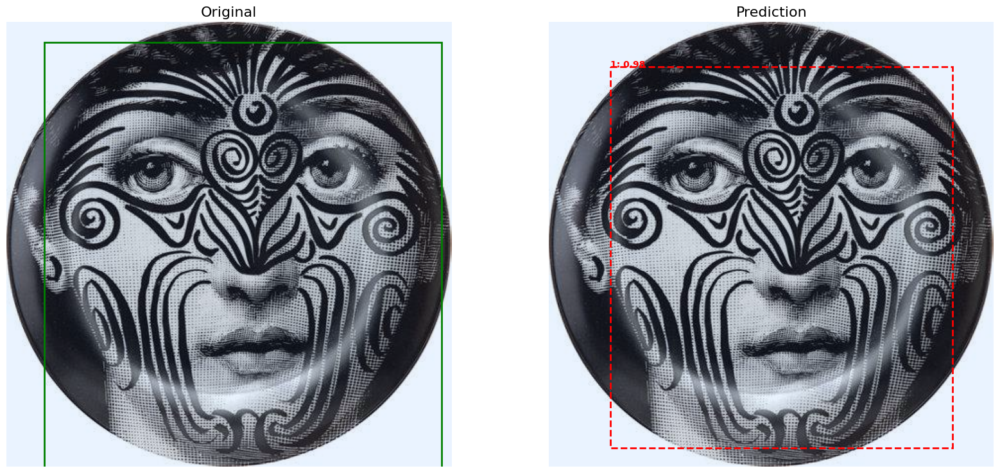

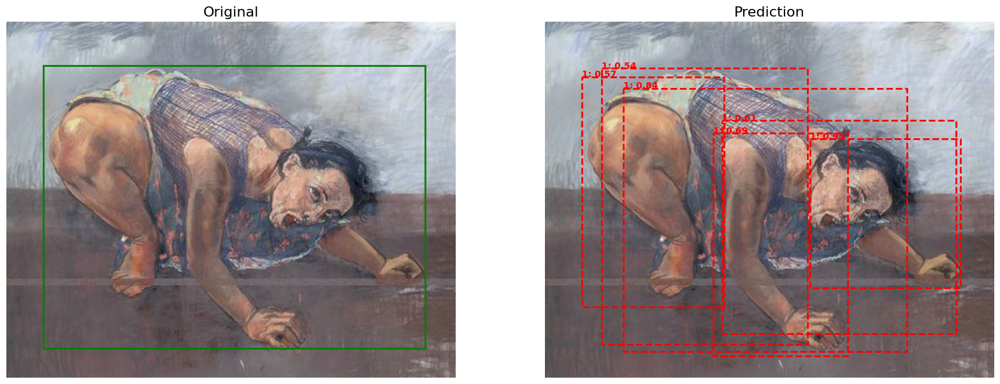

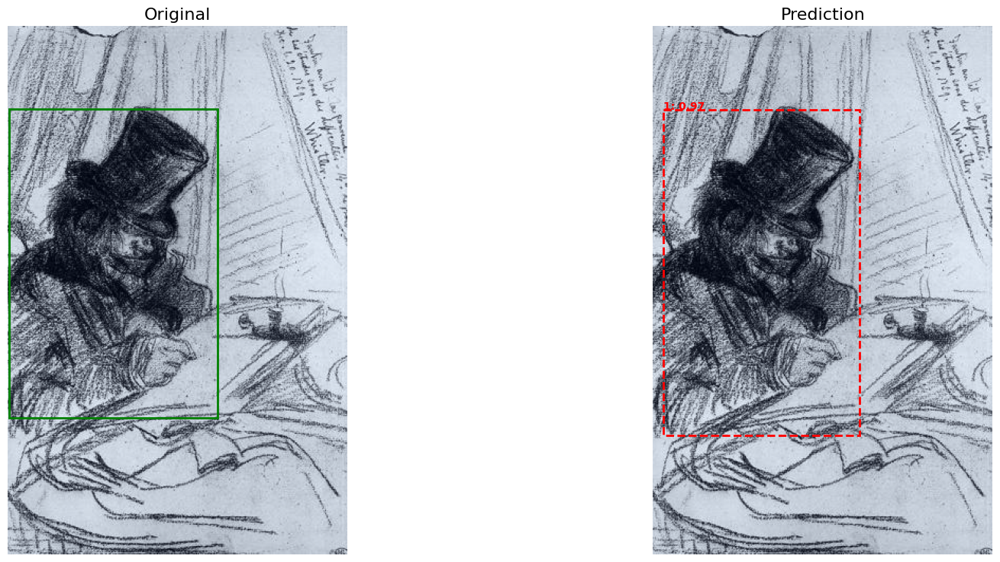

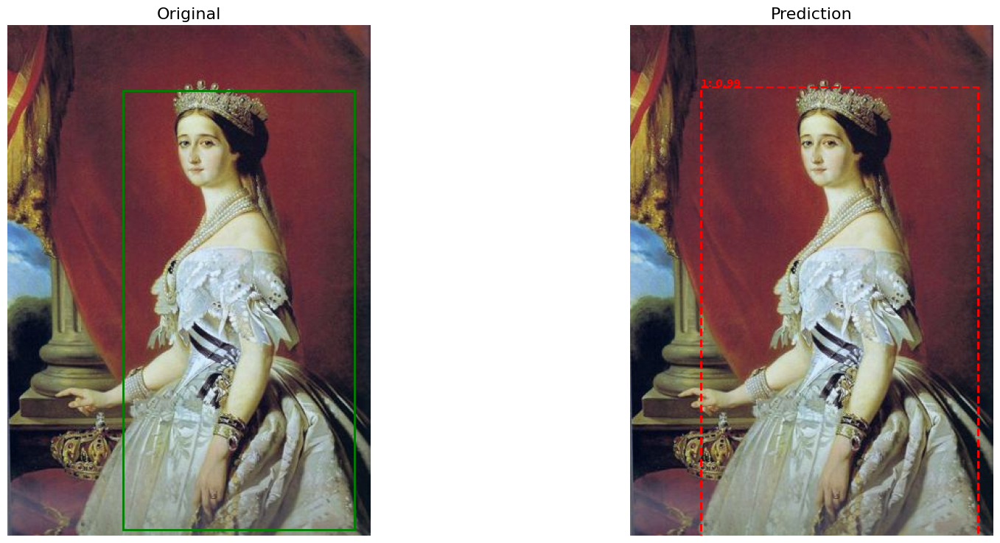

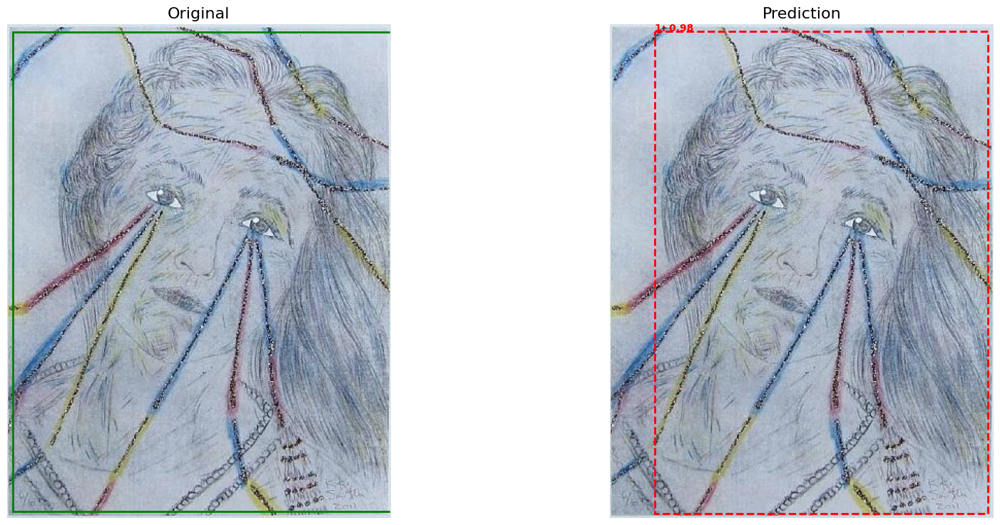

...

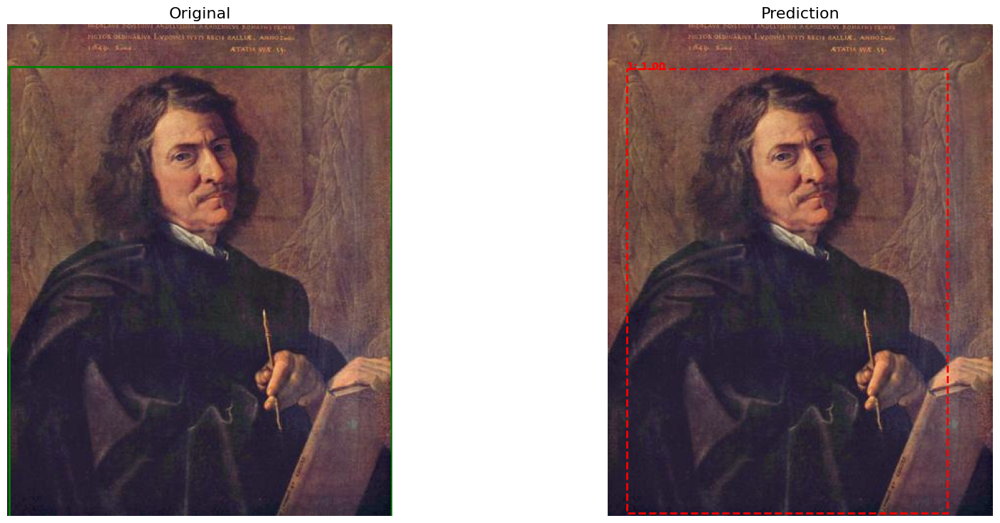

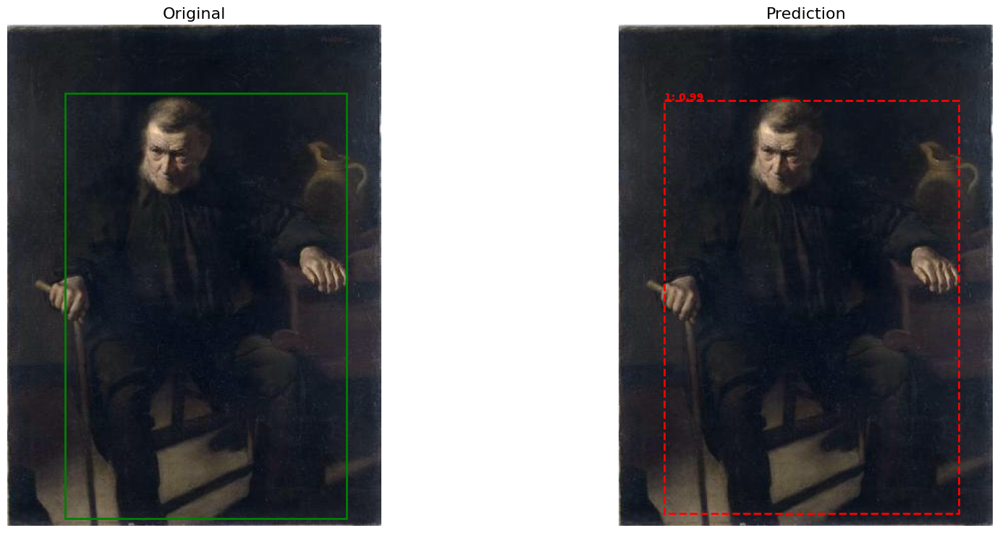

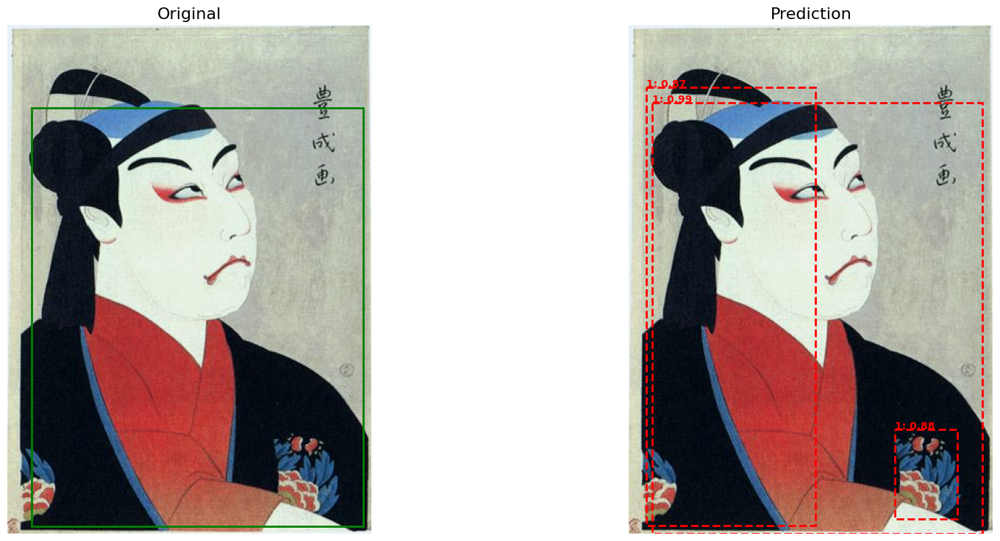

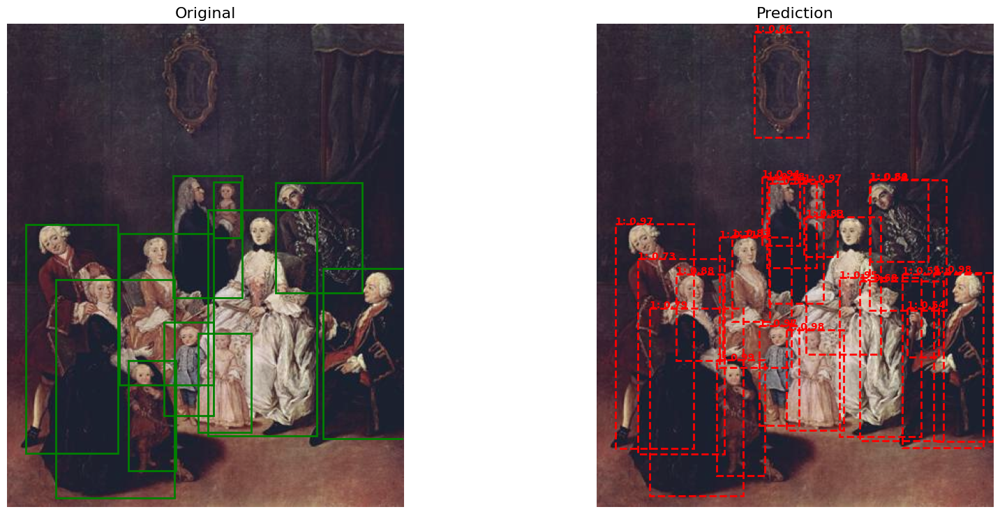

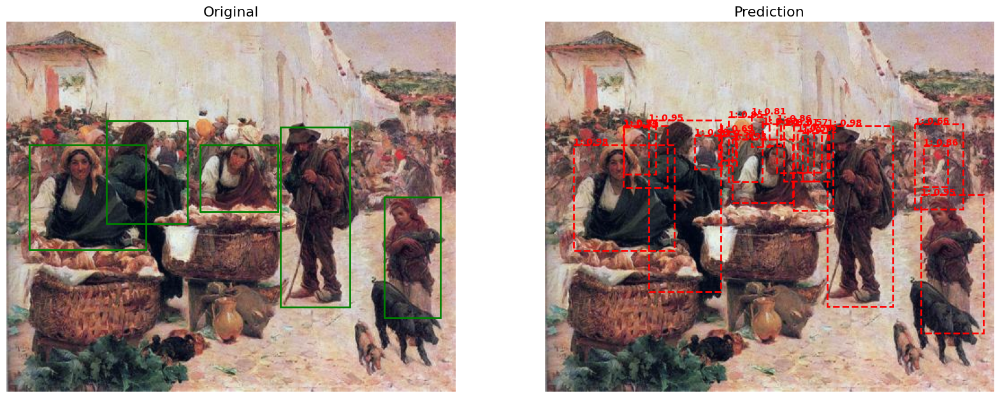

In [ ]:
#test data
import matplotlib.patches as patches

model.eval()
num_samples = 10

with torch.no_grad():
    for i, (images, targets) in enumerate(test_loader):
        if i >= num_samples:
            break

        images = [img.to(device) for img in images]

        # Prediction
        outputs = model(images)

        for j in range(len(images)):
            img = images[j].cpu()

            # Original boxes from targets (here only people)
            true_boxes = targets[j]['boxes'].cpu().numpy()

            # Predicted funds (half confidence interval 0.5 for example)
            pred_boxes = outputs[j]['boxes'].cpu().numpy()
            pred_scores = outputs[j]['scores'].cpu().numpy()
            pred_labels = outputs[j]['labels'].cpu().numpy()

            # Filter predictions by confidence (e.g. > 0.5) and for people only (label=1 if people)
            threshold = 0.5
            filtered_boxes = pred_boxes[pred_scores > threshold]
            filtered_scores = pred_scores[pred_scores > threshold]
            filtered_labels = pred_labels[pred_scores > threshold]

            # plot
            plot_image_side_by_side(img, true_boxes, filtered_boxes, filtered_scores, filtered_labels)


### Load Model

In [ ]:
from google.colab import files
uploaded = files.upload()  # Upload rcnn_model_final.pth

Saving rcnn_model_final.pth to rcnn_model_final.pth


In [ ]:
model_path = "/content/rcnn_model_final.pth"

## Interface

In [ ]:
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.transforms import functional as F
from PIL import Image, ImageDraw
import gradio as gr


# Function to rebuild your trained model
def get_model(num_classes=2):
    from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
    from torchvision.models.detection import fasterrcnn_resnet50_fpn_v2

    model = fasterrcnn_resnet50_fpn_v2(weights=None)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    model.roi_heads.score_thresh = 0.3
    model.roi_heads.nms_thresh = 0.6
    model.roi_heads.detections_per_img = 50
    return model

# Load model correctly
model = get_model(num_classes=2)
model.load_state_dict(torch.load(model_path, map_location="cpu"))
model.eval()


# Annotate output
def draw_boxes(image, boxes, labels, scores, score_threshold=0.5):
    draw = ImageDraw.Draw(image)
    for box, label, score in zip(boxes, labels, scores):
        if score >= score_threshold and label.item() == 1:  # Person class
            draw.rectangle(box.tolist(), outline="red", width=3)
            draw.text((box[0], box[1]), f"Person ({score:.2f})", fill="red")
    return image

# Inference function
def detect_people(image):
    image = image.convert("RGB")
    img_tensor = F.to_tensor(image)

    with torch.no_grad():
        outputs = model([img_tensor])[0]

    boxes = outputs['boxes']
    labels = outputs['labels']
    scores = outputs['scores']

    result_img = draw_boxes(image.copy(), boxes, labels, scores)
    return result_img

# Gradio interface
demo = gr.Interface(
    fn=detect_people,
    inputs=gr.Image(type="pil", label="Upload Painting"),
    outputs=gr.Image(type="pil", label="Detected People"),
    title="People Detection in Paintings (RCNN)",
    description="Upload a painting to detect people using Faster R-CNN (COCO class 1)."
)

demo.launch(share=True, debug=True)


Colab notebook detected. This cell will run indefinitely so that you can see errors and logs. To turn off, set debug=False in launch().
* Running on public URL: https://88f712ff0d220a5ce9.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


Keyboard interruption in main thread... closing server.
Killing tunnel 127.0.0.1:7860 <> https://88f712ff0d220a5ce9.gradio.live
